# Bio-Inspired AI – Week 15 – Artificial Evolution and Evolutionary Robotics – Skills Session 



### Learning Objectives 

* Understand and design the various building blocks of Genetic Algorithms – genotype, phenotype, fitness, selection, crossover, mutation. 

* Choose and optimize the parameters in a genetic algorithm and understand the influence of selection pressure and diversity on the genetic algorithms 

* Consider possible applications and ethical considerations when using genetic algorithms 

### Lecture Review - Basic Concepts 

Having watched the lecture, you should be familiar with the theory behind Genetic Algorithms (GAs) and related areas such as evolutionary robotics. The process of designing a GA can be considered to consist of the following steps 

1. Choose a genetic representation 

2. Build a population 
3. Design a fitness function 

4. Choose a selection operator 

5. Choose a crossover operator 
6. Choose a mutation operator 
7. Devise a data analysis procedure. 

In this lab we examine each of these steps. Part 1 will explore how you frame the problem (Steps 1-3). Part 2 examines how the various operators impact the evolutionary process (Steps 4-6). Finally, Part 3 gives you hands on experience with configuring a genetic algorithm and examining its performance (Step 7).

---
###***Using Google Colab and recording your answers***

Throughout this lab sheet there will be various points where you might like to record your answers or results. If you save a copy of this collab onto your google drive you can do this inside this collab document by double clicking the text cell. If you don't want to use a Google account recording your answers on paper or using a Word document etc. is an equally valid approach.

###***Running code***
The code in this collab is designed to be run sequentially ie. in the order that the exercises appear. If you get an error such as

```
# NameError: name 'foo' is not defined 
```
It is probably because foo was defined in a previous cell. You can run all previous cells by pressing CTRL - F8 or by going to the runtime menu (top left).

---

## Part 1 (10 minutes Total)

<center>

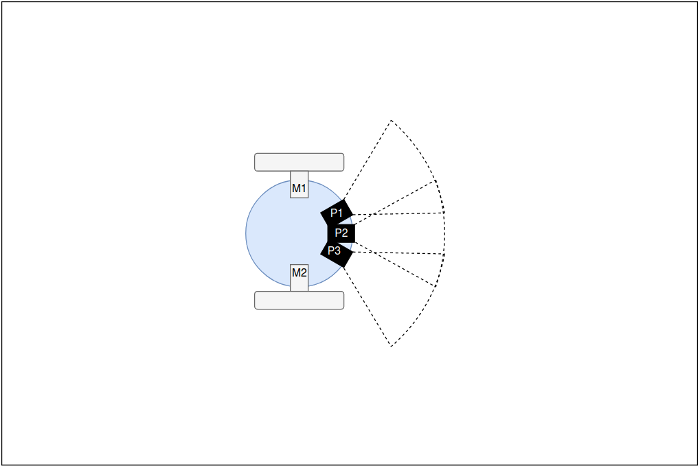

**Figure 1** - A two wheeled cleaning robot in a rectangular room with three proximity sensors </center>


###Exercise 1

A GA is going to used to program the cleaning robot pictured in Figure 1. The robot needs to move about a rectangular room, cleaning as it goes, for as long as possible. Cleaning should be as fast as possible and the robot should avoid hitting the walls as well. The robot can move using two motors controlling two wheels on either side of its body and has three proximity sensors placed about its front. Discuss the following: 

a) What would the genotype used in the GA look like? And what is the phenotype in this case? 

b) What would the initial population look like?

c) What fitness function would you use to evaluate solutions? *Try to think about what behaviour this would reward.*


***You can record your answer here***

---
a)

*   Phenotype - moving around rectangular room & cleaning. Behaviour of robot in the real world.

*   Genotype - code language of the robot. Conde controller. Genomes between M2(P1,P2,P3) and M1(p1,p2,p3). 6 weightings.

b) 

* population - moving around in random directions. 

c)

* fitness function - proportion of room cleaned (over a set time). Completion speed (implicit i.e. if you crash into obstacles you won't complete it as fast)





...


---

## Part 2 (40 minutes Total)

###Part 2 Introduction
A very simple GA will be used in this section to demonstrate the various operators in a GA. The goal of the GA is to guess a word predefined by a user (a guessing game). In this GA the population is formed 8 letter words represented by a discrete genotype in which the alphabet is capital letters. The fitness of individual i is given by:  


$
f(i)=L^2+1
$

Where L is the number of letters in the genotype that match the corresponding letter in the word “INSPIRED”. For example, an individual with the genotype "ARMOURED" would have a fitness of 10.0 as three letters match.  

<center>

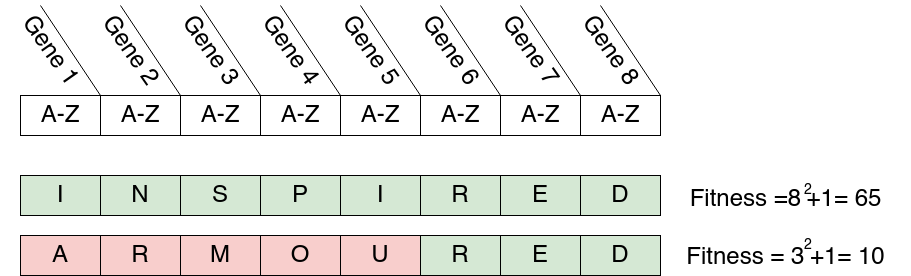

**Figure 2** - The configuration of the genotype and two example genomes with their fitnesses

</center>

###Fitness Function (10 minutes)

The aim of this first excersise is to code the fitness function for the GA described above. Firstly read the code snippet below which contains useful examplar code that will help you complete this task.

***NOTE:*** *For the following exercises we will need to import the numpy library. To do this run the cell below*

In [1]:
import numpy as np # numpy includes many useful mathematical functions and classes. 

In [2]:
def hamming_distance(string1,string2): 
    """Returns the hamming distance between two strings"""    
    #The hamming distance between two strings of equal length is the number of positions at which characters in the string vary.
    #Eg. AAA and BAB have a hamming distance of 2 as two characters (the first and last characters) are different.
    if len(string1)!= len(string2):
        print("Cannot calculate hamming distance, strings {} are different lengths {}".format((string1,string2),(len(string1),len(string2))))
    different_chars = 0        
    for i in range(len(string1)):
        if string1[i] != string2[i]:
            different_chars+=1
    return different_chars


#Two numbers
a = 4
b = 2

#Adding two numbers
ans = a + b #The + operator can be used to add two numbers
print("{} added to {} is {}".format(a,b,ans))

#Calculating the power of a number
ans = a**b #the ** operater raises a to the power of b
print("{} raised to the power of {} is {}".format(a,b,ans))

#Calculating the length of a string
string_A = "INSPIRED"
string_B = "ARMOURED"

#len(string) returns the number of characters in string
print("String A (\"{}\") is {} characters long".format(string_A,len(string_A)))
print("String B (\"{}\") is {} characters long".format(string_B,len(string_B)))

#Calculating the difference betweeen two strings
#hamming_distance(string1,string2) returns the number of characters that are different between two strings 
diff_chars = hamming_distance(string_A,string_B)
print("There are {} characters that are different between strings A and B".format(diff_chars))
same_chars = len(string_A) - hamming_distance(string_A,string_B)
print("There are {} characters that are the same between strings A and B".format(same_chars))

4 added to 2 is 6
4 raised to the power of 2 is 16
String A ("INSPIRED") is 8 characters long
String B ("ARMOURED") is 8 characters long
There are 5 characters that are different between strings A and B
There are 3 characters that are the same between strings A and B


####Exercise 2.1 
The code snippet below calculates the fitness of an individual string, however the calculated fitness is currently wrong. 

Edit the code snippet below to return the correct fitness of the string *individual*. Running the snippet will apply the fitness function across the population. You can use the Table 1 below to verify it is working correctly.


***NOTE:*** *All the mathematical operations you need are given in the previous code snippet*

In [3]:
def evaluate(individual_string):
    """Returns the value of the fitness function f(i) = L(i)^2 +1 when applied to a genome
    
    Parameters:
      individual_string - A string genome representing a word
    Returns:
      The fitness according to the fitness function (float)
    """
    
    correct_word = "INSPIRED"
    matching_letters = (len(correct_word) - hamming_distance(individual_string,correct_word)) #Take away the number of letter that are wrong from the length of the word to give how many letters are correct
    ####################Enter your code here###################
    fitness = 1+matching_letters**2
    ###########################################################
    return fitness

population = np.array(["ABCPIRBE","ABCCAREA","INSPIABC","AAAAAAAA","IABABABA","AAAPIREA"])
#Loop through the population of solutions and display their fitness. Use this to verify your fitness function is working correctly.
for individual in population:
  print("The fitness of {} as calculated is evaluate() is {}".format(individual,evaluate(individual)))

The fitness of ABCPIRBE as calculated is evaluate() is 10
The fitness of ABCCAREA as calculated is evaluate() is 5
The fitness of INSPIABC as calculated is evaluate() is 26
The fitness of AAAAAAAA as calculated is evaluate() is 1
The fitness of IABABABA as calculated is evaluate() is 2
The fitness of AAAPIREA as calculated is evaluate() is 17



|Individual|Fitness|
|:-|:-:|
|ABCPIRBE|10|
|ABCCAREA|5|
|INSPIABC|26|
|AAAAAAAA|1|
|IABABABA|2|
|AAAPIREA|17|


<p><center>Table 1 - An initial population for the GA along side their fitnesses.</center></p>



Now that you've got a working fitness function we can create a handy function that applies it across an entire population. Run the cell to get the fitnesses of an array of individuals. 

In [4]:
def get_fitnesses(population):
    """Returns an array of the fitnesses of each individual in the population"""
    return np.array([evaluate(individual)  for individual in population],dtype = 'float')


population = np.array(["ABCPIRBE","ABCCAREA","INSPIABC","AAAAAAAA","IABABABA","AAAPIREA"])
get_fitnesses(population)

array([10.,  5., 26.,  1.,  2., 17.])

###Selection operator (20 minutes)
The selection operator is used in a GA to pick which solutions should be carried forward into the next generation. 

* What biological principle is this inspired by?

After applying the selection operator you are left with a new generation of solutions to which the crossover and mutation operators are applied. These excerises will demonstrate how selection operators work and will compare their characteristics.


Proportionate selection chooses individuals with a probability proportional to their fitness. (N = population size)

$
p(i) = \frac{f(i)}{\sum_{n=1}^{N} f(n)} 
$

####Exercise 2.2
Double click the cell below to complete the table. To check your answers verify that all selection probabilites add up to one.



|Individual|Fitness|Probability of selection (proportionate)|
|:-       |:-:|:-:|
|ABCPIRBE |10 |0.16|
|ABCCAREA |5  |0.08|
|INSPIABC |26 |    |
|AAAAAAAA |1  |0.02|
|IABABABA |2  |    |
|AAAPIREA |17 |0.28|
|**Total**|   |    |

<p><center>Table 2 - The selection probabilities of the initial population according to proportionate selection.</center></p>

Rank based selection instead chooses individuals based on the rank of their fitness in the population. 



$
p(i) = \frac{N - R_i + 1}{\sum_{n = 1}^{N} R(n)}
$

where the individual with the highest fitness has a rank
$R(i)$=1
and for the least fit individual
$R(i)=N$
 


####Exercise 2.3
Use the formula above to complete the table. To check your answers verify that all selection probabilites add up to one.


|Individual|Fitness|Rank|Probability of selection (Rank-based)|
|:-       |:-:|:-:|:-:|
|ABCPIRBE |10 |3|0.19|
|ABCCAREA |5  |4|0.14|
|INSPIABC |26 | |    |
|AAAAAAAA |1  |6|0.05|
|IABABABA |2  | |    |
|AAAPIREA |17 |2|0.24|
|**Total**|   | |    |

<p><center>Table 3 - The selection probabilities of the initial population according to rank-based selection.</center></p>


####Exercise 2.4
Compare the probabilities of selection between the proportional and rank-based selection methods. Which method causes a higher selection pressure and why? 

***You can record your answer here***

---


...


---


####Selection Code

The code below impliments fitness proportionate, rank-based and tournament selection operators.

***NOTE:*** *To show the code double click the title. When expanded the code can be re-hidden by double clicking the white space/title on the right*

In [5]:
#@title Fitness proportionate selection code
def get_proportionate_select_prob(population,fitnesses):
    """ Returns the selection probabilities for individuals in a population according to proportianate selection
    Parameters:
      population - the population to calculate selection probabilities
      fitnesses - array of fitnesses assocoiated with the individuals in old_population
    
    Returns
      The selection probabilities for each individual
    """    

    total_fitness = np.sum(fitnesses)
    prob_of_selection = fitnesses/total_fitness
    return prob_of_selection
  
def proportionate_selection(old_population,fitnesses):
    """Performs proportional based selection on a population, returns the new population
    Parameters:
        old_population - the population to perform selection on
        fitnesses - array of fitnesses assocoiated with the individuals in old_population
    
    Returns:
        The new population
    """
    if np.isnan(fitnesses).any():
      print("ERROR - Some fitnesses are NaN. Cannot calculate selection probabilities returning original population")
      return old_population

    prob_of_selection = get_proportionate_select_prob(old_population,fitnesses)
    new_population = np.random.choice(old_population, size = len(old_population),p = prob_of_selection)
    return new_population

#Demostrates selection
population = np.array(["ABCPIRBE","ABCCAREA","INSPIABC","AAAAAAAA","IABABABA","AAAPIREA"])
print("Original population: {}".format(population))

new_population = proportionate_selection(population,get_fitnesses(population))

#probabilities = get_proportionate_select_prob(population,get_fitnesses(population))
#print("Selection probabilities {}".format(probabilities))

print("Population after proportionate selection {}".format(new_population))

Original population: ['ABCPIRBE' 'ABCCAREA' 'INSPIABC' 'AAAAAAAA' 'IABABABA' 'AAAPIREA']
Population after proportionate selection ['ABCPIRBE' 'AAAPIREA' 'INSPIABC' 'AAAPIREA' 'AAAPIREA' 'IABABABA']


In [6]:
#@title Rank-based selection code
def get_rank_select_prob(population,fitnesses):
    """ Returns the selection probabilities for individuals in a population according to rank based selection
    Parameters:
      population - the population to calculate selection probabilities
      fitnesses - array of fitnesses assocoiated with the individuals in old_population
    
    Returns
      The selection probabilities for each individual
    """    
    #NOTE: This code does not work correctly for instances where fitnesses are exactly equal. 
    #      Idealy two indentical solutions would be ranked equally such that they have an equal chance of being selected.
    #      However for the porposes of this excerise the code performs correctly 
    
    if np.isnan(fitnesses).any():#If the fitness values aren't valid return an array filled with NaNs for the probabilities
      prob_of_selection = np.full(fitnesses.shape,fill_value = np.nan)
      return prob_of_selection
    
    order = np.array(-fitnesses).argsort() #returns indexes which would sort the array highest to lowest 
    ranks = (order.argsort() +1).astype('float')#sorting the indexes lowest to highest gives us the rank, add one to account for first index being zero
                            
    prob_of_selection = (population.size - ranks + 1.0)/np.sum(ranks)
    return prob_of_selection
    
def rank_based_selection(old_population,fitnesses):
    """Performs rank based selection on a population, returns the new population
    Parameters:
        old_population - the population to perform selection on
        fitnesses - array of fitnesses assocoiated with the individuals in old_population
    Returns:
        The new population
    """

    if np.isnan(fitnesses).any():
      print("ERROR - Some fitnesses are NaN. Cannot calculate selection probabilities returning original population")
      return old_population
    
    prob_of_selection = get_rank_select_prob(old_population,fitnesses)
    new_population = np.random.choice(old_population, size = len(old_population),p = prob_of_selection)

    return new_population
  
#Demostrates selection
population = np.array(["ABCPIRBE","ABCCAREA","INSPIABC","AAAAAAAA","IABABABA","AAAPIREA"])
print("Original population: {}".format(population))

new_population = rank_based_selection(population,get_fitnesses(population))

#probabilities = get_rank_select_prob(population,get_fitnesses(population))
#print("Selection probabilities {}".format(probabilities))

print("Population after rank-based selection {}".format(new_population))

Original population: ['ABCPIRBE' 'ABCCAREA' 'INSPIABC' 'AAAAAAAA' 'IABABABA' 'AAAPIREA']
Population after rank-based selection ['IABABABA' 'AAAPIREA' 'INSPIABC' 'AAAPIREA' 'IABABABA' 'INSPIABC']


In [7]:
#@title Tournament Selection code 
def tournament_selection(old_population,fitnesses,t_size = 2):
    """Performs tournament based selection on a population, returns the new population
    Parameters:
        old_population - the population to perform selection on
        fitnesses - array of fitnesses assocoiated with the individuals in old_population
        t_size - the tournament size
    Returns:
        The new population
    """
    if np.isnan(fitnesses).any():
      print("ERROR - Some fitnesses are NaN. Returning original population")
      return old_population
    new_population = []
    pop_size = old_population.size
    if t_size > pop_size:
        print("Tournament size too big, larger than population size")
        t_size = pop_size
    for i in range(pop_size):
        #pick contentenders for tournament
        contender_indexs = np.random.choice(range(pop_size), replace = False,size = t_size)
        #pick winner aka one with largest fitness of the contenders
        winner_index = contender_indexs[np.argmax(fitnesses[contender_indexs])]

        new_population.append(old_population[winner_index])
    return np.array(new_population)

#Demostrates selection
population = np.array(["ABCPIRBE","ABCCAREA","INSPIABC","AAAAAAAA","IABABABA","AAAPIREA"])
tournament_size = 2

print("Original population: {}".format(population))
new_population = tournament_selection(population,get_fitnesses(population),t_size = tournament_size)
print("Population after tournament selection (t_size = {}) {}".format(tournament_size,new_population))

Original population: ['ABCPIRBE' 'ABCCAREA' 'INSPIABC' 'AAAAAAAA' 'IABABABA' 'AAAPIREA']
Population after tournament selection (t_size = 2) ['AAAPIREA' 'AAAPIREA' 'INSPIABC' 'INSPIABC' 'ABCCAREA' 'ABCCAREA']


To enable us to easily switch between selection methods we will write a selection function, where the selection method is a parameter.

In [8]:
def perform_selection(old_population,fitnesses,selection_method,selection_params=None):
    """Applies a selection operator on a population, returns the new population
    Parameters:
        old_population - the population to perform selection on
        selection_method - The selection operator to be applied, valid values are:
                           "proportionate","rank" or "tournament"
        selection_params - Dictionary of parameters for selection operators 
    Returns:
        The new population
    """ 
    if selection_method == "proportionate":
        new_population = proportionate_selection(old_population,fitnesses)
    elif selection_method == "rank":
        new_population = rank_based_selection(old_population,fitnesses)
    elif selection_method == "tournament":
        new_population = tournament_selection(old_population,fitnesses,selection_params["tournament_size"])
    else:
        print("\"{}\" is not recognised as a selection method. Returning original population".format(selection_method))
        new_population = old_population
    return new_population

We'll also provide a measure of diversity within the population. This measures how different all the individuals in the population are



In [9]:
def get_diversity(population):
    """Returns the diversity measure of a population (pair-wise sum of hamming distances)
    Parameters:
      population - The population to calculate the diversity for
    Returns
      The diversity in the population
    """
    #One diversity measure is the all-possible-pairs diversity. 
    #For our genotype this can be defined as the sum of hamming distances between every possible pair of individauls in the population
    sum_of_hamming = 0
    for individual1 in population:
         for individual2 in population:
            sum_of_hamming+=hamming_distance(individual1,individual2)
    return sum_of_hamming

#### Exercise 2.5

The code cell below applies a selection operator to a population to create a new population. The fitnesses,diveristy and individuals of each population are then displayed.

In [10]:
selection_method = "tournament" #valid values are "proportionate","rank" or "tournament"
selection_params = {"tournament_size" : 2}

#The old population and their fitnesses
population = np.array(["ABCPIRBE","ABCCAREA","INSPIABC","AAAAAAAA","IABABABA","AAAPIREA"])
fitnesses  = get_fitnesses(population)

#The new population is formed by applying the selection operator
new_population = perform_selection(population,fitnesses,selection_method,selection_params)
new_fitnesses = get_fitnesses(new_population)

print("----------- Selection method: {} -----------".format(selection_method))

print("Original population: {}    Diversity  : {:4.2f}".format(population,get_diversity(population)))
print("Original fitnesses : {}    Avg fitness: {:4.2f}".format(fitnesses,np.mean(fitnesses)))    

print("New population     : {}    Diversity  : {:4.2f}".format(new_population,get_diversity(new_population)))
print("New fitnesses      : {}    Avg fitness: {:4.2f}".format(new_fitnesses,np.mean(new_fitnesses)))


----------- Selection method: tournament -----------
Original population: ['ABCPIRBE' 'ABCCAREA' 'INSPIABC' 'AAAAAAAA' 'IABABABA' 'AAAPIREA']    Diversity  : 166.00
Original fitnesses : [10.  5. 26.  1.  2. 17.]    Avg fitness: 10.17
New population     : ['INSPIABC' 'AAAPIREA' 'AAAPIREA' 'ABCCAREA' 'AAAPIREA' 'INSPIABC']    Diversity  : 128.00
New fitnesses      : [26. 17. 17.  5. 17. 26.]    Avg fitness: 18.00


Choose a selection operator on the top line then run the code cell. Then answer the following. 


a) What happens to the mean fitness in the population after selection? Is this what you expected and why?

***Note***: If run the cell and you haven't completed Exercise 2.1 your fitnesses will show as "nan" (Not A Number). Please refer to the solution on blackboard so you can continue with the lab. 

***You can record your answer here***

---


...


---

b) What happens to the population’s diversity after selection? Is this what you expected and why?

***You can record your answer here***

---


...


---


c) Run the code cell several times (at least ten), noting the new populations each time. Is the fittest individual always copied from the original population to the new one? Why is this done and what is this called? 

***You can record your answer here***

---


...


---

### Crossover (5 minutes)
After a new generation has been created, the crossover operator combines individuals to form new ones. This happens with a certain probability. 

* What biological principle is this inspired by? 

Depending on your genome different operators are required. For this exercise we will consider the simplest, one-point crossover. 

<center>

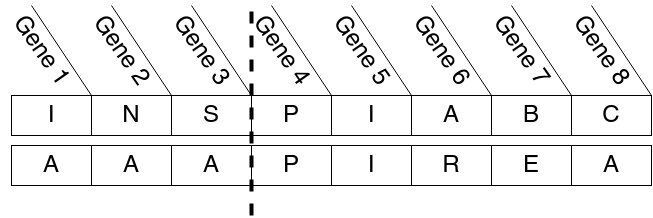

**Figure 3** - Illustration of the individuals “INSPIABC” and “AAAPIREA” and the thick black line where crossover should take place.

</center>

#### Exercise 2.6

Apply one-point crossover between the third and fourth characters in the genomes "INSPIABC" and "AAAPIREA". What are the fitnesses of the two resultant genomes? What does this tell you about the purpose of crossover in the GA?

***You can record your answer here***

---


...


---


You can use the function in the cell below to verify your answer.

In [11]:
def one_point_crossover(individual1,individual2,crossover_point = -1):
  """Applies one point crossover to two individual genomes
  Parameters:
    individual1 - Genome1
    individual2 - Genome2
    crossover_point (optional, default = -1) - The crossover point in the genome string ie. the position in the string before which the crossover is applied. 
                                               If set to -1 a random crossover point will be used. 
  Returns:
     The two individuals 
  """ 
  if (len(individual1)!=len(individual2) or len(individual1) == 0 or len(individual2) == 0):
    print("Individual genome sizes must be equal and larger than zero")
    return individual1,individual2
  if crossover_point == -1:#No crossover point set, generate a random one
    crossover_point = np.random.randint(1,len(individual1))

  if crossover_point > len(individual1) or crossover_point > len(individual2):
    print("Crossover point {} larger than genome sizes ({})".format(crossover_point,individual1,individual2))
  
  #Select the appropriate sections of the genome string and exchange them
  new_individual1 = individual1[:crossover_point] + individual2[crossover_point:]
  new_individual2 = individual2[:crossover_point] + individual1[crossover_point:]
  
  return new_individual1,new_individual2


#The two genomes to apply crossover to
individual1 = "AAAAAAAA"
individual2 = "BBBBBBBB"

#Applies one point crossover to the individuals new_individual1 and new_individual2
#Note: A crossover point between the 1st and 2nd characters in genome would be 1
new_individual1,new_individual2 = one_point_crossover(individual1,individual2,5)

print("Results of crossover = {}".format((new_individual1,new_individual2)))
print("New fitnesses = {}".format(get_fitnesses([new_individual1,new_individual2])))

Results of crossover = ('AAAAABBB', 'BBBBBAAA')
New fitnesses = [1. 1.]


### Mutation (5 minutes)

Mutation introduces random changes in individuals. The mutation probability controls the frequency at which this happens. 

* In nature where does this occur? 
  

####Exercise 2.7

Run the code cell below to mutate the individual "INSPIAAA". How does the fitness of the mutated individual compare to the original?

In [12]:
def generate_random_char():
  """Returns a random capital letter character"""
  random_char = chr(np.random.randint(65,91))#First a random number above 65 and including 90 is generated then covertted to an ASCII symbol
                                             #ASCII character 65 = A ASCII character 90 = Z, symbols between these are all capital letters
  return random_char
def mutate(individual):
  #Generates a random number between zero and eight, this is the gene we will mutate
  gene_num = np.random.randint(0,8)

  #puts a randomly generated genome (character) at the position specified by gene_num
  individual = individual[:gene_num] + generate_random_char() + individual[gene_num+1:] 
  return individual

mutate("INSPIAAA")

'HNSPIAAA'

***You can record your answer here***

---


...


---


#### Exercise 2.8
If the mutation rate was zero, and the initial population is that of Table 3, is it possible for the GA to achieve the highest possible fitness through crossover alone? Ie. Eight matching letters. What does this tell you about the purpose of mutation in the GA?

|Individual|Fitness|
|:-|:-:|
|ABCPIRBE|10|
|ABCCAREA|5|
|INSPIABC|26|
|AAAAAAAA|1|
|IABABABA|2|
|AAAPIREA|17|


<p><center>Table 3 - An initial population for the GA along side their fitnesses. This is the same as Table 1 but has been reproduced here for convenience. </center></p>


***You can record your answer here***

---


...


---


###Putting it all together (optional extension)



You have now examined each of the essential components of a genetic algoirthm. This final section will show how they can be assembled together. This section is optional.

If you refer to the steps at the start of the lab sheet we are missing a way to build an initial population. This is usally done randomly as demonstrated with the code below.

In [13]:
def generate_population(population_size,genome_size = 8):
  """
  Generates a new population of genomes of letter strings

  Parameters:
    population_size - The size of the new population
    genome_size (optional) (default = 8) - The size of each genome string
  
  Returns:
    The new population
  """

  #Adds randomly generated individuals to a list representing the population
  population = []
  for i in range(population_size):

    new_individual = "" #The genome starts as an empty string
    for c in range(genome_size):#loops through each gene in the genome
      random_char =  generate_random_char()#generates a random gene and appends it to the new genome
      new_individual+= random_char
    #Once created the genome is added to the population
    population.append(new_individual)

  return np.array(population) #Convert the list into a numpy array as this is what the other functions expect

generate_population(6)

array(['NJPWZODA', 'VGNJJARR', 'THVXWETF', 'OPUWTZZA', 'JLQFOZAP',
       'EBHNRYGQ'], dtype='<U8')

We'll also create a function to print out the state of the population so we can see if our GA has worked

In [14]:
def print_population_stats(population):
  """Prints the best fitness, mean fitness and diversity in the population"""

  fitnesses  = get_fitnesses(population)
  max_fitness = np.max(fitnesses)
  mean_fitness = np.mean(fitnesses)
  diversity = get_diversity(population)
  print("Population stats   Best fitness = {:4.2f}   Mean fitness = {:4.2f}   Diversity = {:4.2f}".format(max_fitness,mean_fitness,diversity))

print_population_stats(population)

Population stats   Best fitness = 26.00   Mean fitness = 10.17   Diversity = 166.00


The code below impliments the GA we have been examining in this section. 
* Run the code cell, did the solution to the guessing game ("INSPIRED") exist in the final population?


In [15]:
#How many generations the GA will be run for
generation_num = 5000

selection_method = "rank" #valid values are "proportionate","rank" and "tournament"
selection_params = {"tournament_size" : 2}#parameters for the selection method 

#These probabilities decide how often to apply the crossover and mutation operators to the selected population
#In this implimentation crossover and mutation occur sequentially
crossover_rate = 0.1 #The probability of performing crossover on a individual per generation
mutation_rate = 0.01 #The probability of performing mutation on an individual per generation

#Initialise the population

population = np.array(["ABCPIRBE","ABCCAREA","INSPIABC","AAAAAAAA","IABABABA","AAAPIREA"]) # The population examined in the previous excersises
#population = generate_population(6) #Uncomment this line to generate a random population of 6 individuals

print("-----------Initial population-----------")
print(population)
print_population_stats(population)

#Begin the evolution loop
for g in range(generation_num):

  #Evaluate the individuals
  fitnesses = get_fitnesses(population)
  if np.isnan(fitnesses).any():#Breaks the loop if the fitness function isn't implimented
    print("ERROR - Fitness function not implimented!")
    break
  #Select the fitest individuals
  population = perform_selection(population,fitnesses,selection_method,selection_params)
  
  #Apply crossover operations
  for individual1_index in range(population.size):

    if np.random.random() < crossover_rate: #Crossover happens with a certain probability
      
      #Select an individual to do crossover with
      potential_individuals = list(range(population.size))
      potential_individuals.remove(individual1_index)     #can't do crossover with the same individual (nothing would change)
      individual2_index = np.random.choice(potential_individuals)

      #Apply one point crossover to produce new individuals
      new_individual1,new_individual2 = one_point_crossover(population[individual1_index],population[individual2_index])
      
      #Insert the new individuals back into the population
      population[individual1_index] = new_individual1
      population[individual2_index] = new_individual2

  
  #Apply mutation operations
  for individual_index in range(population.size):
    if np.random.random() < mutation_rate:#Decide to apply a mutation or not   
      population[individual_index] = mutate(population[individual_index])


print("-----------End population-----------")
print(population)
print_population_stats(population)

-----------Initial population-----------
['ABCPIRBE' 'ABCCAREA' 'INSPIABC' 'AAAAAAAA' 'IABABABA' 'AAAPIREA']
Population stats   Best fitness = 26.00   Mean fitness = 10.17   Diversity = 166.00
-----------End population-----------
['INSPINQD' 'INSPINQD' 'INSPINQD' 'INSPINQD' 'INSPINQD' 'INSPINQD']
Population stats   Best fitness = 37.00   Mean fitness = 37.00   Diversity = 0.00


###Part 2 Conclusion
Hopefully this section has given you a deeper understanding of the inner workings of a GA. The GA examined in this excersise was fairly trivial, since we already knew what the solution we wanted to evolve was. However, GAs become particularly useful when we don't know what the solution to a problem is, as you will find in the next section.

25##Part 3 (40 Minutes Total)

In this section we will use a genetic algorithm to train a supervisor to control a group of robots to search an environment with the goal of covering as much of the area as possible.

In this scenario we consider three elements to the problem: 

*   A set of robots that we can command to navigate around the environment.
*   An environment we wish to explore, containing boxes at different positions. 
*   A control strategy to command the robots that is evolved.



**The Environment**: 

We will examine simple indoor environments as shown below. The environment is covered in blue squares which signify objectives that the robots need to reach. 

**The Robots**:  

Here we consider a group of three robots that can be commanded to move in different directions. The robots can collectively be commanded to disperse and head in eight different directions. The robots will head in these directions whilst repelling from each other and obstacles.    

In addition, we can control the spread between the robots such that they can be very tightly packed or spread far apart.  

**The Control Strategy**: 

Given an environment to explore and a group of robots to control, the task is to evolve a control strategy that will command the robots to achieve the best coverage.  

Here we will use behaviour trees to represent the genome that we evolve. A tree will contain an ordered sequence of commands that we will optimize through evolution. 

We enable the tree to make decisions by looking at the position of the center of the group of robots as well as its spread. An example of a tree is shown below.


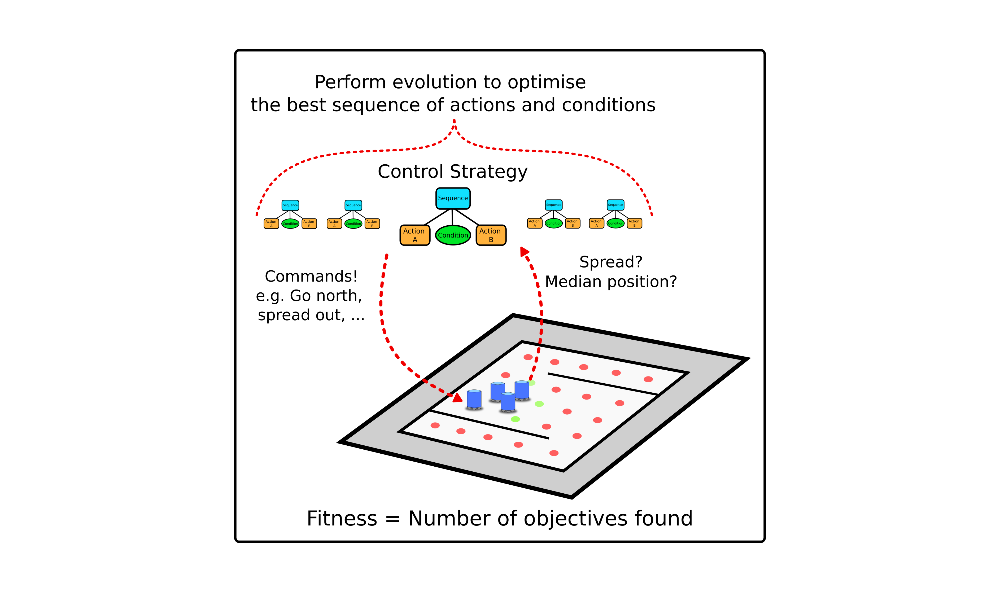


**How do they work?**

For each tree, each node is triggered from left to right in sequence. When reaching a condition node show in green, if the condition is FALSE, the sequence will stop and start again from the beginning. 

This allows us to trigger different stages of commands based on generated conditions. 

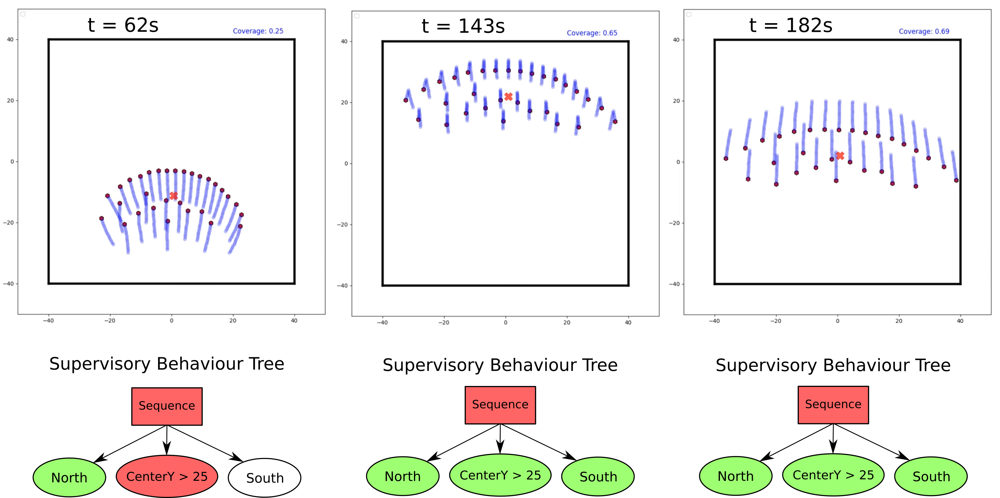

The tree above would first command the robots to head north, whilst the center of mass is not greater than 25 in the y-direction, the robots will continue heading north. Once the statement is true, the robots would then be directed south. 

To summarise, the goal of the evolution is to find the best sequence of actions and conditions to control the group of robots to reach all the objectives. 

We define the fitness for this problem as follows: 


> **Fitness = (objectives found/total objectives) – tree cost*tree size**




---



**Download the code**

Begin by running the code snippet below to clone the required libraries into your workspace which will allow us to run the simulations.

In [16]:
# %cd /content
# Clone/Update the entire repo.
# ! git -C evo_demo pull || git clone https://github.com/jhird11/evo_demo.git evo_demo

# Change directory into cloned repo
# %cd evo_demo

# List repo contents
# !ls

#import required libaries
import random
import sys
import numpy as np
import math
import scipy
import matplotlib.pyplot as plt
from numpy.linalg import norm
from scipy.spatial.distance import cdist, pdist, euclidean

import simulation.bsim as bsim
import simulation.environment as environment
import behtree.treegen as tg
import behtree.tree_nodes as tree_nodes
import evo.evaluate as evaluate
import evo.operators as op

from matplotlib import animation, rc
from IPython.display import HTML

import py_trees
import matplotlib.image as mpimg


# Simulation environment

Before performing evolution you can familarize yourself with the simulator and observe how a group of robots moving around randomly performs. In this case the random walk does not work very well so we therefore want to use evolution to promote better solutions.

The code will take a short time to run the simulation and then render the playback so please be patient.

Once finished, you will see simulation pop up below the code. You can then play the simulation and speed up or slow down the playback as you wish.

In [22]:
swarmsize = 100
global swarm
swarm = bsim.swarm()
swarm.size = swarmsize
swarm.speed = 1
swarm.behaviour = 'random'
swarm.param = 0.01
swarm.gen_agents()

targets = bsim.target_set()
targets.set_state('set1')
targets.radius = 3
targets.reset()

env = bsim.map()
env.map1()
env.gen()
swarm.map = env

field, grid = bsim.potentialField_map(env)
swarm.field = field
swarm.grid = grid

# First set up the figure, the axis, and the plot element we want to animate
fig, ax = plt.subplots(num=None, figsize=(8,8), dpi=100, facecolor='w', edgecolor='k')
plt.close()

dim = 52
ax.set_xlim((-dim, dim))
ax.set_ylim((-dim, dim))

# Set how data is plotted within animation loop
global line, target_found_line,target_unfound_line
# Agent plotting 
line, = ax.plot([], [], 'rh', markersize = 6, markeredgecolor="black", alpha = 0.9)
# Box plotting
target_found_line, = ax.plot([], [], 'gs', markersize = 8, markeredgecolor="black", alpha = 0.5)
target_unfound_line, = ax.plot([], [], 'bs', markersize = 8, markeredgecolor="black", alpha = 0.5)
#Text plotting
plot_text = ax.text(0.5, 0.95,'',horizontalalignment='center',verticalalignment='center',transform = ax.transAxes,size = 'large')


line.set_data([], [])
target_found_line.set_data([], [])
target_unfound_line.set_data([], [])

def init():
    target_found_line.set_data([], [])
    target_unfound_line.set_data([], [])
    plot_text.set_text('')
    return (line, target_found_line,target_unfound_line,plot_text)

[ax.plot([swarm.map.obsticles[a].start[0], swarm.map.obsticles[a].end[0]], 
    [swarm.map.obsticles[a].start[1], swarm.map.obsticles[a].end[1]], 'k-', lw=2) for a in range(len(swarm.map.obsticles))]

timesteps = 1000
score = 0
noise = np.random.uniform(-.01,.01,(timesteps, swarm.size, 2))

anim_type = 'random_swarm'

swarm.behaviour = 'random'
swarm.param = 0.02

def animate(i): 
    swarm.iterate(noise[i-1])
    swarm.get_state()
    score = targets.get_state_normal(swarm, i, timesteps)
    
    x = swarm.agents.T[0]
    y = swarm.agents.T[1]    
    line.set_data(x, y)

    unfound_targets = targets.targets[targets.old_state==False]
    a = unfound_targets.T[0]
    b = unfound_targets.T[1]
    target_unfound_line.set_data(a, b)

    found_targets = targets.targets[targets.old_state]
    a = found_targets.T[0]
    b = found_targets.T[1]
    target_found_line.set_data(a, b)

    plot_text.set_text("Targets found: {:d}/{:d}".format(score,len(targets.targets)))
    return (line, target_found_line,target_unfound_line,plot_text)

anim = animation.FuncAnimation(fig, animate, init_func=init,
                            frames=timesteps, interval=200, blit=True)
plt.show()
# Note: below is the part which makes it work on Colab
# rc('animation', html='jshtml')
anim

Animation size has reached 20999033 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


# Running the evolution

The following block of code will run the genetic algorithm for this problem.

This will run 50 generations before finishing and you will see the progress print out as the evolution advances and will plot the average and maximum fitness when complete. This will take a little while to complete so please be patient and you can try familiarising yourself with the code whilst you wait.

Focus on the section that describes the paramters of the evolutionary process which we need to tune. Those parameters are also shown here.

|Parameter|Value|
|:-|:-:|
|Number of generations|50|
|Population size|10|
|Elite size|2|
|Tournament size|3|
|Mutation rate per tree node|0.15|
|Random subtree growth per mutation|0.5|
|Tree size cost per node|0.001|



---



Read below for more detailed background info on the operators used in this algorithm.

**Tournament selection**

This algorithm uses tournament selection to select good individuals before performing crossover and mutation. This process involves performing multiple rounds of tournaments where a set of individuals are randomly selected and the individual with the best fitness is then passed to the next stage of crossover and mutation. A large tournament size creates high selection pressure, with increased liklihood of only keeping the best solutions. A small tournament size has low selection pressure and lower performing solutions have more chance to be selected for the next generation.

**Elitism**

Elitism passes a proportion of the best individuals them straight into the next generation without any changes through crossover or mutation. This allows us to hold onto the best solutions without possible making them worse through crossover or mutation. Note that these best individuals can still be selected through tournament selection and therefore we still use the best solutions to try and find better ones.

**Single point crossover**

After selection, we take two trees and perform single point crossover to two sections from each tree. The selected sub-trees are then swapped with the opposing tree.

**Mutation**

Finally, for each tree we cycle through every node and with a set probably mutate some parameter of that node. There is also a probability of growing a new random sub-tree which can add new genetic material.



GEN:  0
Evaluating Individual:  0  Gen:  0
score =  5
-------------------------------------------------------------------
Individual fitness: 0.008
Evaluating Individual:  1  Gen:  0
score =  14
-------------------------------------------------------------------
Individual fitness: 0.176
Evaluating Individual:  2  Gen:  0
score =  13
-------------------------------------------------------------------
Individual fitness: 0.128
Evaluating Individual:  3  Gen:  0
score =  0
-------------------------------------------------------------------
Individual fitness: 0.000
Evaluating Individual:  4  Gen:  0
score =  21
-------------------------------------------------------------------
Individual fitness: 0.238
Evaluating Individual:  5  Gen:  0
score =  0
-------------------------------------------------------------------
Individual fitness: 0.000
Evaluating Individual:  6  Gen:  0
score =  11
-------------------------------------------------------------------
Individual fitness: 0.083
Evaluati

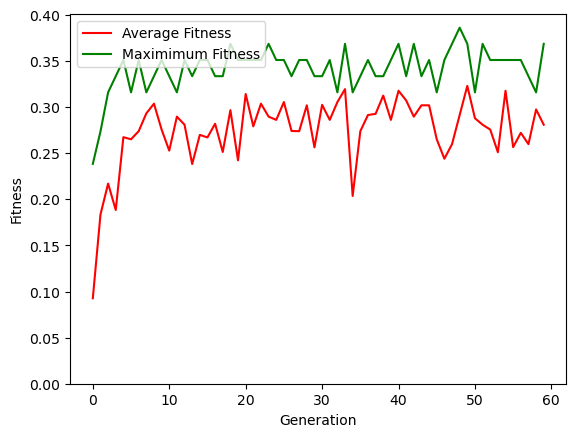

In [23]:
# Top level execution of evolutionary algorithm

''' Required inputs to evolutionary algorithm:
	
	1. Create swarm object:
		- Define the swarm size.
		- Initialize with behavior 'none'.
		- Set agent speed.
		- Generate an array of agent positions.

	2. Create environment object:
		- Assign the environment object to the swarm.map attribute.

	3. Create the set of targets to search for:
		- Create a target set object and set it's state to match the environment.
		- Set the detection radius.
'''

	# Set random seed
#random.seed(1000)
seed = 1000
random.seed(seed)
np.random.seed(seed)

# Create swarm object
swarmsize = 30
swarm = bsim.swarm()
swarm.size = swarmsize
swarm.behaviour = 'none'
swarm.speed = 0.5
swarm.origin = np.array([0, 0])
swarm.gen_agents()

# Create environment
env = bsim.map()
'''
Check that environment is set to the right one! 
'''
env.bounded = True
env.map1() 
env.gen()
swarm.map = env

targets = bsim.target_set()
targets.set_state('set1')
targets.radius = 1.5
targets.reset()

# The test duration for each search attempt
timesteps = 500

fields = []
fitness_maps = []
field, grid = bsim.potentialField_map(env)
trials = 1

	###############################################################################

	#                     EDIT THIS SECTION OF CODE ONLY

'''
	EVOLUTIONARY PARAMETERS:
	NGEN - Number of evoltuionary generations.
	popsize - Number of individuals in each population.
	indsize - The maximum depth of trees that are initially generated.
	tournsize - The number of individuals taken in each tournament selection.
	mutrate - Probability of performing a mutation on a node of a tree.
	growrate - Probability of growing a random tree during mutation.
	growdepth - The depth of randomly grown trees.
	hallsize - The number of individuals saved in the hall of fame.
	elitesize - The number of the best individuals saved between generations.  
'''

NGEN = 60; popsize = 10; indsize = 2
tournsize = 4; mutrate = 0.02; growrate = 0.5; growdepth = 1

hall = []; hallsize = 20; newind = 0
elitesize = 4
treecost = 0.01

	# NOTE: keep the treecost < 0.01 and > 0.001

'''
	The blackboard is a python dictionary which contains all the possible paramters
	which can be used to build our robot supervisor.

	For instance, the "actions" entry contains all the types of behaviours that the 
	robot can perform and allow the supervisor to change what the robots are doing.

	The "metrics" entry describe how the supervisor can see the swarm, here we 
	can look at the median position of all the robots and their density.
	Using these metrics we can build condition statements within the behaviour tree
	and manipulate using evolutionary mutation operators.
	'''

blackboard = {"operators": ['sel','seq'], 
				"opsize": [2,3,4,5,6,7],
				"act_types": ['act','param'],
				"actions": ['disperse','north','south','west','east','southeast',
															'southwest','northeast','northwest'],
				"dirparam": [10,30,60],
				"rotparam": [0.01,0.02,0.03,0.04,0.05,0.06,0.07,0.08,0.09],
				"randparam": [0.01,0.02,0.03],
				"envcontrol": ['attract','repel'],
				"envcontrol_x": [-10,-8,-6,-4,-2,0,2,4,6,8,10],
				"envcontrol_y": [-10,-8,-6,-4,-2,0,2,4,6,8,10],
				"metrics": ['medianx', 'mediany', 'density'],
				"dimx": [-30,-20,-16,-12,-8,-4,0,4,8,12,16,20,30],
				"dimy": [-30,-20,-16,-12,-8,-4,0,4,8,12,16,20,30],
				"density": [2,6,10,14,18,22,26],
				"coverage": [0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9]
				}


	##################################################################################

op_prob = 0.55
selectionNum = popsize - elitesize - newind

# Generate starting population
pop = []
generations = []*NGEN
pop = [tg.individual(tg.tree().make_tree(indsize, blackboard)) for t in range(popsize)]

#  Logging variables
logfit = []; logpop = []; logavg = []; logmax = []
stats = {"avgsize": [], "stdsize": [], "meanfit": [], "stdfit": [], "maxfit": []}

# Start evolution!
for i in range(0, NGEN):
	print ('GEN: ', i) 
	newpop = []		
	# Serial execution
	evaluate.serial_search(pop, swarm, targets, i, timesteps, treecost, field, grid)

	# Record results -------------------------------------------------------------------------------------------------
	pop.sort(key=lambda x: x.fitness, reverse=True)
	op.log(pop, hall, logpop, logfit, logavg, logmax, i)
	hall = op.hallfame(pop, hall[:], hallsize)
	
	# Generate the next population -----------------------------------------------------------------------------------
	elite = [ind.copy() for ind in pop[0:elitesize]]

	# Remove worst individuals
	newpop = op.tournament(pop[:], tournsize, selectionNum)
			# Perform crossover on selected individuals from tournament selection
	newpop = op.crossover(newpop[:], op_prob)
	# Finally perform mutation on all trees
	newpop = op.mutate(newpop[:], mutrate, growrate, growdepth, blackboard)

	pop = []
			# Add the elite individuals to the new population
	pop = list(newpop + elite)
  
print('\n\nEvolution has finished.\n\n')

print('\n The best solution had a fitness of %.2f.\n\n' % (hall[0].fitness))

# Plot the average and max fitness

fig, ax = plt.subplots()	
		
ax.plot(logavg, 'r-', label="Average Fitness")
ax.plot(logmax, 'g-', label="Maximimum Fitness")

ax.set_xlabel("Generation")
ax.set_ylabel("Fitness")
ax.set_ylim(bottom = 0)

legend = ax.legend(loc="upper left")

plt.show()


#View the behaviour tree (optional)

If you are interested you can render the tree of the best indivdial into an image with the nipet below.

Writing c:\Users\aasav\github-classroom\EMAT31530\group-project-2\Aasav\GA Algorithm Simple Breakdown\tree.dot
Writing c:\Users\aasav\github-classroom\EMAT31530\group-project-2\Aasav\GA Algorithm Simple Breakdown\tree.png
Writing c:\Users\aasav\github-classroom\EMAT31530\group-project-2\Aasav\GA Algorithm Simple Breakdown\tree.svg


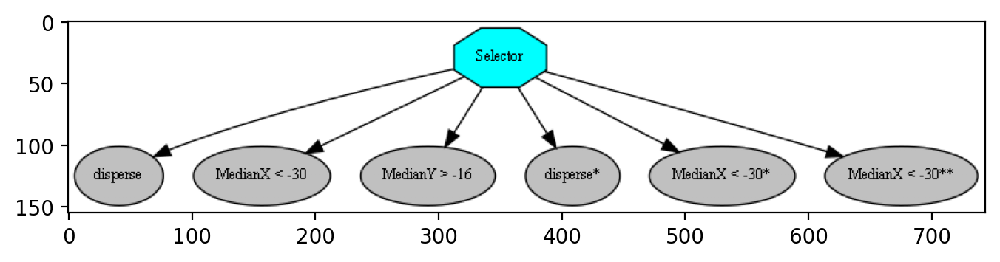

In [24]:
bt = tg.tree().decode(hall[0], swarm, targets)
bt.setup(timeout=15)

py_trees.display.render_dot_tree(bt.root, name ='tree')
plt.figure(num=None, figsize=(8, 8), dpi=200, facecolor='w', edgecolor='k')
img=mpimg.imread('tree.png')
imgplot = plt.imshow(img)

# Running the best solution

After running the evolution the following snippet will simulate the best individual produced over the evolution.



In [25]:
#@title Animate evolved solution
swarmsize = 30
global swarm
swarm = bsim.swarm()
swarm.size = swarmsize
swarm.speed = 0.5
swarm.behaviour = 'random'
swarm.param = 0.01
swarm.gen_agents()

targets = bsim.target_set()
targets.set_state('set1')
targets.radius = 3
targets.reset()

env = bsim.map()
env.map1()
env.gen()
swarm.map = env

field, grid = bsim.potentialField_map(env)
swarm.field = field
swarm.grid = grid

# First set up the figure, the axis, and the plot element we want to animate
fig, ax = plt.subplots(num=None, figsize=(8,8), dpi=100, facecolor='w', edgecolor='k')
plt.close()

dim = 52
ax.set_xlim((-dim, dim))
ax.set_ylim((-dim, dim))

# Set how data is plotted within animation loop
global line, target_found_line,target_unfound_line
# Agent plotting 
line, = ax.plot([], [], 'rh', markersize = 6, markeredgecolor="black", alpha = 0.9)
# Box plotting
target_found_line, = ax.plot([], [], 'gs', markersize = 8, markeredgecolor="black", alpha = 0.5)
target_unfound_line, = ax.plot([], [], 'bs', markersize = 8, markeredgecolor="black", alpha = 0.5)
#Text plotting
plot_text = ax.text(0.5, 0.95,'',horizontalalignment='center',verticalalignment='center',transform = ax.transAxes,size = 'large')


line.set_data([], [])
target_found_line.set_data([], [])
target_unfound_line.set_data([], [])

def init():
    target_found_line.set_data([], [])
    target_unfound_line.set_data([], [])
    plot_text.set_text('')
    return (line, target_found_line,target_unfound_line,plot_text)

[ax.plot([swarm.map.obsticles[a].start[0], swarm.map.obsticles[a].end[0]], 
    [swarm.map.obsticles[a].start[1], swarm.map.obsticles[a].end[1]], 'k-', lw=2) for a in range(len(swarm.map.obsticles))]

timesteps = 500
score = 0
noise = np.random.uniform(-.01,.01,(timesteps, swarm.size, 2))

bt = tg.tree().decode(hall[0], swarm, targets)

def animate(i): 
    bt.tick()
    swarm.iterate(noise[i-1])
    swarm.get_state()
    score = targets.get_state_normal(swarm, i, timesteps)
    
    x = swarm.agents.T[0]
    y = swarm.agents.T[1]    
    line.set_data(x, y)

    unfound_targets = targets.targets[targets.old_state==False]
    a = unfound_targets.T[0]
    b = unfound_targets.T[1]
    target_unfound_line.set_data(a, b)

    found_targets = targets.targets[targets.old_state]
    a = found_targets.T[0]
    b = found_targets.T[1]
    target_found_line.set_data(a, b)

    plot_text.set_text("Targets found: {:d}/{:d}".format(score,len(targets.targets)))
    return (line, target_found_line,target_unfound_line,plot_text)

anim = animation.FuncAnimation(fig, animate, init_func=init,
                            frames=timesteps, interval=200, blit=True)
plt.show()
# Note: below is the part which makes it work on Colab
rc('animation', html='jshtml')
anim

Watch the solution playback and you should see how the addition of the evolved supervisor controls the direction of the robots. As the artificial evolution uses many random operations, you may have different solutions to your neighbours.


*   Discuss with your neighbours the solution that you have produced and see if there are any differences between your solutions and maximum.

**Tuning the algorithm**

You most likely saw the robots cover some of the area whilst much of the map wasn't reached. Your main task is to try and improve the performance of your algorithm and produce better solutions. You will have to do this by adjusting the parameters highlighted in the table above.

*   Keep the number of generations and population size the same.
*   Think about the size of the tournament selection and elite size relative to the size of the population.
*   How will the mutation rate effect the production of new solutions? Think about this with respect to good solutions that need minor changes.
*   How does the tree size cost effect the production of new solutions?
 
*Tuning a genetic algorithm can be a difficult process and it is important that you don't change too many parameters at once otherwise it will be difficult to know which change had a positive or negative effect. Also keep a note of the maximum fitness produced each time you run each evolution and a note of the parameters you change. 

If you find you are not making progress ask one of the TAs for help. You can also work in teams to discuss your progress and reasoning behind changing certain parameters.

**Further work**

**In real applications we would typically use at least 200 generations based on the complexity of the problem and a larger population size. Due to the constraints of the lab duration we have had to run very short evolutions. In your own time you can try running an evolution with a much higher number of generations and a larger population size. You should see better solutions emerge with the benefit of more time to evolve and more population diversity. Note that this could take an hour or more to run.*



# Applications and ethical considerations (10 mins)

Having now developed an understanding of genetic algorithms and how they operate consider the following:

* When and why would you use genetic algorithms? Can you think of any potential applications that weren’t in the lab?  

* What are their limitations? 

* Can you think of any ethical considerations that need to be made when using genetic algorithms for a particular problem?

Put your answers here in padlet: https://padlet.com/jhird2/gwn6opdzd5qma63 